<a href="https://colab.research.google.com/github/yjmantilla/ica_tutorial/blob/main/LABPDS_PROYECTO_ICA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Proyecto Análisis de Componentes Independientes PDS 2020-1
### Yorguin José Mantilla Ramos
CC.1127617499
 
Grupo:3

### 1. Introducción

El análisis de componentes independientes (ICA) es una técnica de separación de señales fuentes a ciegas (blind signal source separation). Explicar el funcionamiento interno del algoritmo va más alla del propósito de esta guía; sin embargo es importante tener en cuenta las suposiciones del modelo y su uso desde un punto de vista de entrada-salida, es decir, como una caja negra (black-box).

#### 1.1 Motivación

El problema con el que generalmente se plantea el análisis de componentes independientes es el llamado "problema de la fiesta de cóctel". En general plantea como es posible que el humano sea capaz de identificar y concentrarse en una voz al estar inmerso en una gran cantidad de ruido (como por ejemplo en una fiesta). Debe haber una forma en el procesamiento auditivo de la persona sea capaz de "separar" las fuentes de sonido. El algoritmo ICA sin embargo no pretende ser un modelo biologicamente-factible; sino que es una forma de resolver el problema desde el punto de vista estadístico.

#### 1.2 Modelo

El algoritmo ICA se plantea matemáticamente usando algebra lineal de la siguiente forma:

$$X=AS$$
$$S=WX$$
$$W=A^{-1}$$

Donde:
- $X$ es la matriz de *observaciones* ("el sonido capturado por varios microfonos"). Sus dimensiones son (sensores,muestras).
- $S$ es la matriz de *fuentes* ("las fuentes sonoras que queremos hallar"). Sus dimensiones son (fuentes,muestras)
- $A$ es la matriz de *mezcla* y representa la forma en que las fuentes se combinaron de forma lineal para producir las observaciones. Sus dimensiones son (sensores,fuentes)
- $W$ es la matriz de *desmezcla* y representa la forma en que podemos obtener las fuentes a partir de las observaciones. Sus dimensiones son (fuentes,sensores).

El algoritmo ICA internamente trata de encontrar el par de matrices $A$ y $W$, a partir del conjunto de datos $X$ y al menos una restricción en cuánto a las dimensiones de la matrices $A$ y $W$, esto último corresponde al *orden* de la descomposición; en otras palabras cuántas fuentes se supone que hay que encontrar.

#### 1.3 Suposiciones del modelo
1. Las fuentes son no gaussianas
2. Las fuentes son estadísticamente independientes
3. La combinación de las fuentes se realiza de forma lineal
4. Hay por lo menos tantas observaciones (micrófonos) como fuentes que se esperan.

#### 1.4 Funcionamiento

Como ya se dijo más arriba el funcionamiento interno va más alla de esta guía. Hay muchos algoritmos ICAs que toman ideas desde la estadística y de la teoría de la información por ejemplo. 

A un nivel canónico el ICA trata de utilizar estadísticas de orden superios (HOS, Higher Order Statistics) para hacer la separación.

Desde el punto de vista de optimización el algoritmo trata de maximizar la independencia estadística de las componentes encontradas.






### 2. Caracterización de las señales


#### 2.1 Descarga de las señales desde google drive

In [ ]:
!gdown --id 1-NWv8h6bO7PyPTXjGBV9F22tCdXQWDuW -O 'file0.flac'
!gdown --id 1-cok88C6WQTG4LLxfiZUgwzRTqijXdEY -O 'file1.flac'
!gdown --id 1Ru0UI6xb6No06ytDXARzt8q9YaB80VlL -O 'file2.flac'
!gdown --id 1mFRHA_o6mndBZwHLFiKRatzP_n2wKx68 -O 'file3.flac'


Downloading...
From: https://drive.google.com/uc?id=1-NWv8h6bO7PyPTXjGBV9F22tCdXQWDuW
To: /content/file0.flac
22.1MB [00:00, 133MB/s]
Downloading...
From: https://drive.google.com/uc?id=1-cok88C6WQTG4LLxfiZUgwzRTqijXdEY
To: /content/file1.flac
21.7MB [00:00, 101MB/s] 
Downloading...
From: https://drive.google.com/uc?id=1Ru0UI6xb6No06ytDXARzt8q9YaB80VlL
To: /content/file2.flac
18.2MB [00:00, 160MB/s]
Downloading...
From: https://drive.google.com/uc?id=1mFRHA_o6mndBZwHLFiKRatzP_n2wKx68
To: /content/file3.flac
12.1MB [00:00, 190MB/s]


#### 2.2 Lectura de las señales en python

Lea las señales en python. ¿Cuál es la frecuencia de muestreo? ¿Cuántos canales tienen los audios? Busque una forma de reducir los audios a un solo canal. Coloque los canales en un iterable (ya sea lista o vector).

In [ ]:
!pip install soundfile
import soundfile as sf # lectura de archivos flac
import numpy as np


tracks = []
n_files = 4

names = ['file'+str(i)+'.flac' for i in range(4)]


for i in range(4):
  data, samplerate = sf.read('/content/'+names[i])
  # Volvemos la señal "MONO" al promediar los dos canales originales
  tracks.append(np.mean(data,axis=-1)) 

del data
tracks = np.array(tracks)
print(tracks.shape)

# es el mismo para todos los archivos, así que no importa usar el ultimo
print('samplerate',samplerate)


(4, 9781183)
samplerate 48000


- fs = 48KHz
- Los audios tienen dos canales por lo que por facilidad se reducen a uno ya sea por eliminación o por promedio.

#### 2.3 Graficación de las señales en tiempo.
Grafique algunos segundos de las señales (por ejemplo 10), si puede, de forma superpuesta.

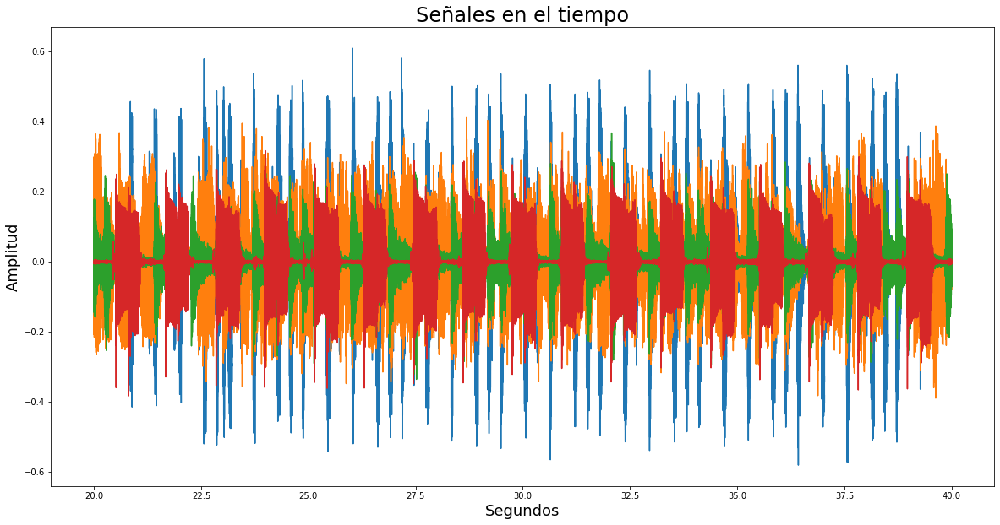

In [ ]:
import matplotlib.pyplot as plt
def s2f(seconds,samplerate=48000):
  """Convierte de segundos a muestras dada una frecuencia de muestreo.
  """
  return int(seconds*samplerate)

start = s2f(20)
stop  = s2f(40)
plt.figure(figsize=(20,10)) 
plt.plot(np.linspace(20,40,tracks[:,start:stop].shape[1]),tracks[:,start:stop].T)
plt.title('Señales en el tiempo',fontsize=24)
plt.xlabel('Segundos',fontsize=18)
plt.ylabel('Amplitud',fontsize=18)
plt.show()

#### 2.4 Escucha de las señales
Escuche las señales por separado. ¿Puede describir que contiene cada una? Por ejemplo ¿que instrumentos?.

In [ ]:
from IPython.display import Audio # para reproducción de audio

labels = ['percusión','vocales','guitarra','bajo']
for i in range(tracks.shape[0]):
  print(labels[i])
  display(Audio(tracks[i,start:stop],rate=samplerate))

percusión


vocales


guitarra


bajo


1. Percusión
2. Vocales
3. Guitarra
4. Bajos

#### 2.5 Espetrogramas.
Grafique los espectrogramas de las señales. ¿Que puede deducir de ellos? ¿Hay superposición de espectros entre las señales? ¿Piensa que se pueden separar todas las señales mediante filtros? ¿Por qué si y por qué no?

Es recomendable que las gráficas sean de una ventana de tiempo.

percusión


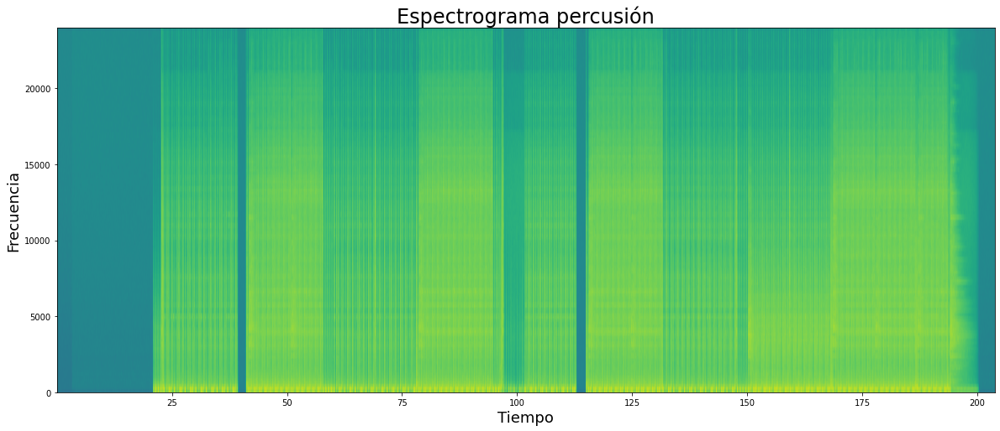

vocales


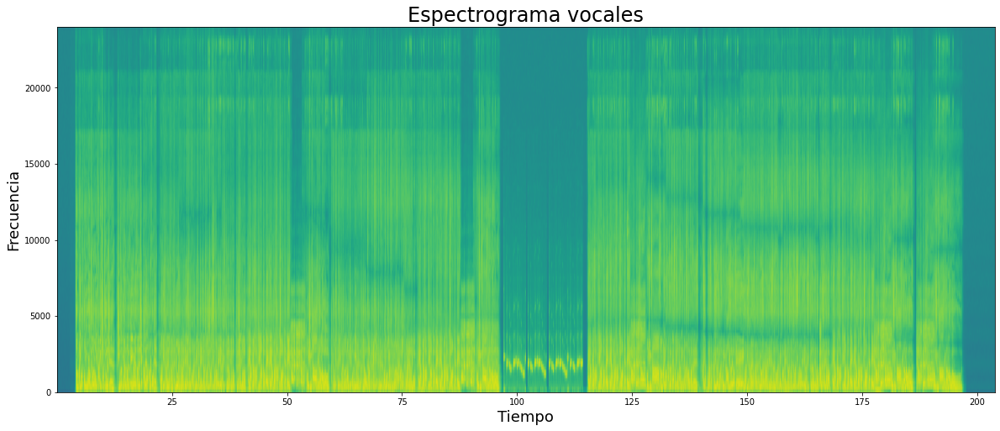

guitarra


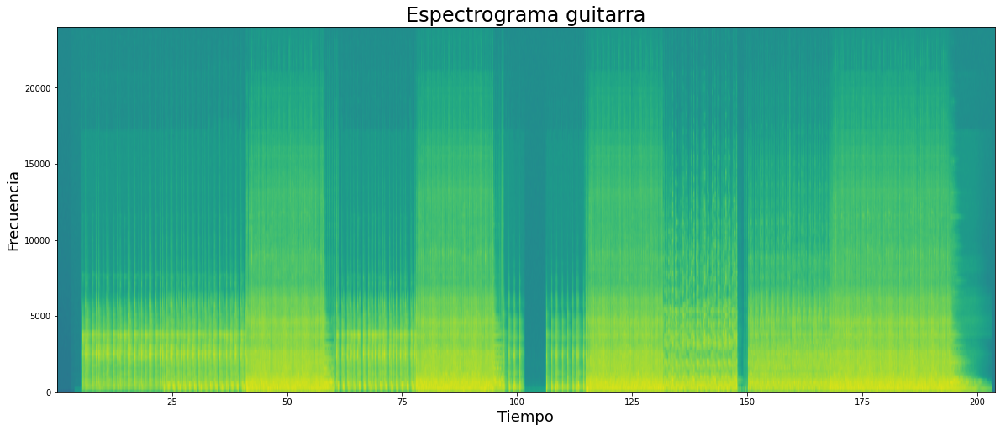

bajo


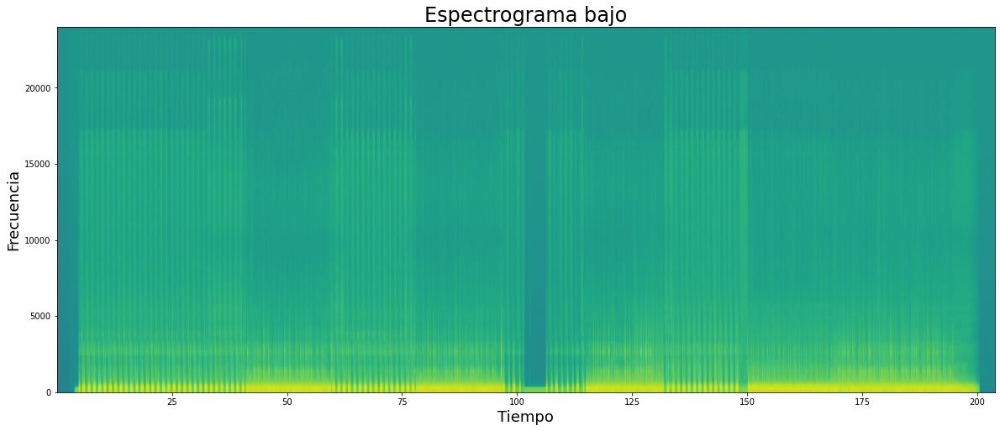

In [ ]:
for i in range(tracks.shape[0]):
  print(labels[i])
  plt.figure(figsize=(20,8))
  plt.specgram(tracks[i,:],Fs=samplerate) # si es muy pesado usar start:stop
  plt.title('Espectrograma '+ labels[i],fontsize=24)
  plt.xlabel('Tiempo',fontsize=18)
  plt.ylabel('Frecuencia',fontsize=18)
  plt.show()

- Algunos instrumentos tienen cierto grado de separación frecuencial, por lo que sería posible obtener una separación mediante filtros. 
- Sin embargo la calidad de esta separación podría no ser tan buena ya que si hay superposición.
- Por ejemplo separar el bajo de la percusión no sería tan fácil ya que al filtrar algunos componentes de la percusión quedarían dentro del filtro pasabajas.

2.6 ¿Son las señales gaussianas?
Grafique el histograma de cada una de las señales.

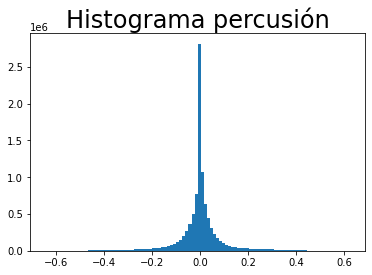

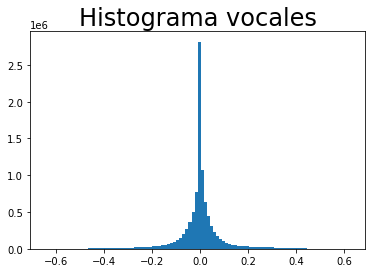

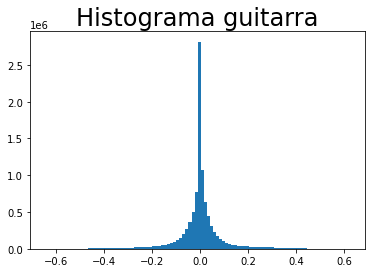

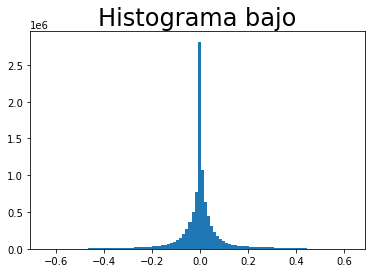

In [ ]:
for i in range(tracks.shape[0]):  
  plt.hist(tracks[0,:],100)
  plt.title('Histograma '+labels[i],fontsize=24)
  plt.show()


- A pesar de que la distribución es simétrica y centrada en 0, la curva no es propiamente gaussiana. 
- En este sentido las señales podrían ser separadas por el algoritmo ICA.

### 3. Topografía de Mezcla
En esta sección la idea es mezclar los sonidos al simular una mezcla "espacial" al disponer 25 micrófonos en una cuadricula y colocando una fuente sonora (una señal) en cada esquina.

Para evitar divisiones por cero posteriormente se puede optar por poner las fuentes sonoras por fuera de la cuadrícula como se ve en la siguiente imagen.

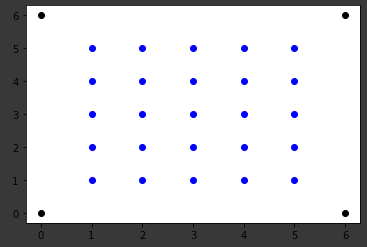

#### 3.1 Haga un código en python que generen los pares coordenados de los sensores y grafiquelos.

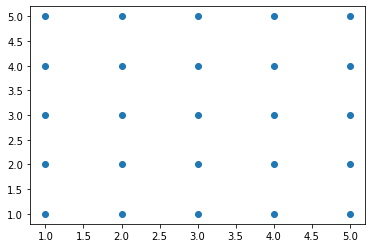

In [ ]:
# Topografía de Sensores

num_rows = 5
num_cols = 5

# Borde superior izquierdo en (0,0)
def gen_sensor_grid(num_rows=5,num_cols=5):
    sensors = []
    for i in range(num_rows):
        for j in range(num_cols):
            sensors.append((j+1,i+1))
    return sensors

sensor_locs = gen_sensor_grid(num_rows,num_cols)
n_sensors = len(sensor_locs)

sensor_locs = np.array(sensor_locs)
#print(sensor_locs)
x_coordinates = [s[0] for s in sensor_locs]
y_coordinates = [s[1] for s in sensor_locs]

sensor_pos ={'x':x_coordinates,'y':y_coordinates}
plt.scatter(x_coordinates, y_coordinates)
plt.show()

##### 3.2 Haga un código en python que generen los pares coordenados de los sensores y grafiquelos.

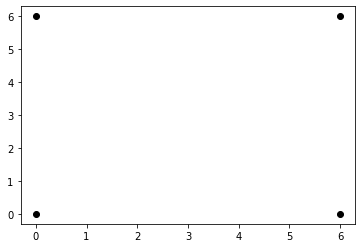

In [ ]:
def gen_source_locs(num_rows=5,num_cols=5):
    source_locs = []
    for row in [0,num_rows+1]: #bordes verticales
        for col in [0,num_cols+1]: #bordes horizontales
                source_locs.append((col,row))
    return source_locs

source_locs = gen_source_locs(num_rows,num_cols)
n_sources = len(source_locs)
source_locs = np.array(source_locs)
#print(source_locs)
x_coordinates = [s[0] for s in source_locs]
y_coordinates = [s[1] for s in source_locs]

source_pos ={'x':x_coordinates,'y':y_coordinates}

plt.scatter(x_coordinates, y_coordinates,c='k')
plt.show()

##### 3.3 Superponga las topografías de sensores y fuentes


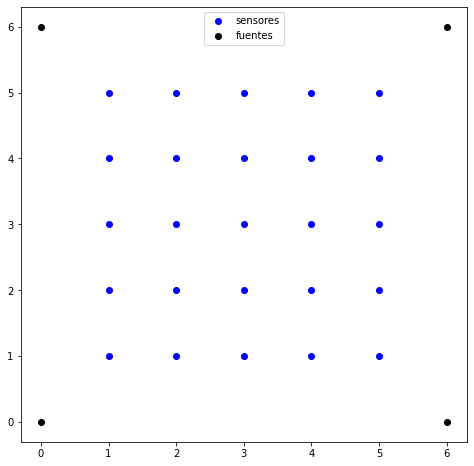

In [ ]:
colors = ['b','k']
plt.figure(figsize=(8,8))
for i,pos in enumerate([sensor_pos,source_pos]):
  plt.scatter(pos['x'],pos['y'],c=colors[i])

plt.legend(['sensores','fuentes'],loc='upper center')
plt.show()


#### 3.4 Generación de matriz de mezcla
Use la ley de los inversos cuadrados para generar la matriz de mezcla. Recuerde que la matriz de mezcla tiene dimensiones (sensores,fuentes) y en cada entrada tiene la intensidad del sonido que llega a un determinado microfono, proveniente de una determinada fuente.

$$Intensidad = \frac{1}{r^2}$$

donde r es el radio de separación del emisor y el receptor.

$$r^{2}=(x_{emisor}-x_{receptor})^2 + (y_{emisor}-y_{receptor})^2$$

In [ ]:
# Matriz de Mezcla

A = np.zeros((n_sensors,n_sources))

for sensor in range(n_sensors):
    for source in range(n_sources):
        # [0]--> X
        # [1]--> Y
        r2 = (source_locs[source][0] - sensor_locs[sensor][0])**2 + (source_locs[source][1] - sensor_locs[sensor][1])**2
        A[sensor,source] = 1./r2

print(A)

[[0.5        0.03846154 0.03846154 0.02      ]
 [0.2        0.05882353 0.03448276 0.02439024]
 [0.1        0.1        0.02941176 0.02941176]
 [0.05882353 0.2        0.02439024 0.03448276]
 [0.03846154 0.5        0.02       0.03846154]
 [0.2        0.03448276 0.05882353 0.02439024]
 [0.125      0.05       0.05       0.03125   ]
 [0.07692308 0.07692308 0.04       0.04      ]
 [0.05       0.125      0.03125    0.05      ]
 [0.03448276 0.2        0.02439024 0.05882353]
 [0.1        0.02941176 0.1        0.02941176]
 [0.07692308 0.04       0.07692308 0.04      ]
 [0.05555556 0.05555556 0.05555556 0.05555556]
 [0.04       0.07692308 0.04       0.07692308]
 [0.02941176 0.1        0.02941176 0.1       ]
 [0.05882353 0.02439024 0.2        0.03448276]
 [0.05       0.03125    0.125      0.05      ]
 [0.04       0.04       0.07692308 0.07692308]
 [0.03125    0.05       0.05       0.125     ]
 [0.02439024 0.05882353 0.03448276 0.2       ]
 [0.03846154 0.02       0.5        0.03846154]
 [0.03448276 

#### 3.5 Visualización de la matriz de mezcla

Haga una función que le permita visualizar las matrices de mezcla. La visualización es en esencia pintar la influencia de una fuente en cada uno de los sensores; dicha información esta codificada en las columnas de la matriz de mezcla. En ese sentido deberá hacer tantas gráficas como fuentes haya.

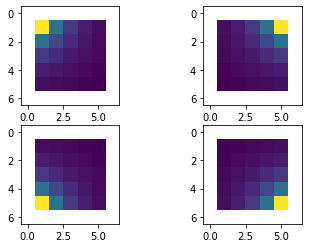

In [ ]:
import scipy.interpolate
def plot_topos(A,sensors,max_x,max_y):
    # Cuadricula de subplots
    nrows = int(np.ceil(np.sqrt(A.shape[1])))
    ncols = int(np.ceil(np.sqrt(A.shape[1])))
    fig, axs = plt.subplots(nrows, ncols)
    accum = 0
    for i in range(nrows):
        for j in range(ncols):
            accum +=1
            if accum > A.shape[1]: # ir a la siguiente linea de la cuadricula de subplots
                continue
            values = A[:,accum-1] # obtener la intensidad de la fuente actual a todos los sensores
            gridx, gridy = np.meshgrid(np.linspace(0, max_x, max_x+1),np.linspace(0, max_y, max_y+1))
            grid = scipy.interpolate.griddata(sensors, values, (gridx,gridy), method='linear') # interpolar valores para la grilla
            axs[i,j].imshow(grid)
            #axs[i,j].colorbar()
    plt.show()

plot_topos(A,sensor_locs,num_cols+1,num_rows+1) #+1 para incluir la locación de las fuentes

#### 3.6 Mezcla de las señales

Mezcle las señales de acuerdo al modelo planteado en la introducción; esto es, obtenga la matriz de observaciones $X$.

In [ ]:
X = A @ tracks # operador @ es equivalente al producto de matrices

##### 3.7 Escuche algunos de los sensores ¿Que nota?

In [ ]:
# Sensor superior izquierdo 
sensor = 0
print('Sensor superior izquierdo')
display(Audio(X[sensor,start:stop],rate=samplerate))
# Sensor inferior derecho
print('Sensor inferior derecho')
display(Audio(X[-1,start:stop],rate=samplerate))

Sensor superior izquierdo


Sensor inferior derecho


- En el sensor superior izquierdo se escucha mucho la percusión
- En el sensor inferior derecho se escucha mucho el bajo

### 4 Algoritmo ICA



#### 4.1 Haga una función que implemente el ICA de scikit learn para separar las señales. Conviene leer la documentación para saber como obtener los resultados. Haga que el orden de descompoisición sea un parámetro de entrada. ¿Que orden de descomposición se debería usar? 

In [ ]:
# Single ICA
from sklearn.decomposition import FastICA # ICA
def do_ICA(X,n_components_ica=None,maxiter_ica=200):
    if n_components_ica is None:
      n_components_ica = np.linalg.matrix_rank(X)
    transformer = FastICA(n_components=n_components_ica,random_state=0,max_iter=maxiter_ica)
    S = np.transpose(transformer.fit_transform(np.transpose(X)))
    W = transformer.components_
    A = transformer.mixing_
    return A, W



En este caso sabemos a priori que fueron 4 fuentes entonces el orden de descomposición debería ser 4.

##### 4.2 Ejecución del algoritmo ICA
Utilice el orden que considera conveniente. Puede ser que este apartado demore mucho en ejecutar.

In [ ]:
A,W = do_ICA(X,4) # What happens if we lower the input data length


#### 4.3 Desmezcle la señal valiendose del modelo planteado en la introducción y escuche el resultado. ¿Que tan buena es la calidad de separación?¿Se logró separar en cada fuente? ¿ En qué orden estan las fuentes?

In [ ]:
S = W @ X
start = s2f(20)
stop  = s2f(40)
for i in range(S.shape[0]):
  display(Audio(S[i,start:stop],rate=samplerate))

- Se logran aislar bien las fuentes originales
- Sin embargo si se logra escuchar muy levemente a veces los otros instrumentos
- Pero en general la separación logra aislar el bajo, las vocales, la percusión y la guitarra.
- Generalmente al correr el algoritmo el orden recuperado no corresponde al orden original de las fuentes en la matriz.

##### 4.4 Visualize las matrices de Mezcla obtenidas mediante el ICA. 
¿Qué puede concluir?

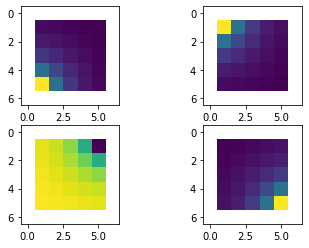

In [ ]:
plot_topos(A,sensor_locs,num_cols+1,num_rows+1)

- Podemos notar que las matrices tienen algunas magnitudes invertidas.
- Esto ilustra que la fase no necesariamente es recuperada por el ICA.

##### 4.5 ¿Que ocurre si se usan apenas 1000 muestras de los audios? Concluya.

In [ ]:
stop = 1000
start = 0
A,W = do_ICA(X[:,start:stop],4)

S = W @ X
start = s2f(20)
stop  = s2f(40)
for i in range(S.shape[0]):
  display(Audio(S[i,start:stop],rate=samplerate))
plot_topos(A,sensor_locs,num_cols+1,num_rows+1)

- La separación disminuye la calidad notablemente.
- Esto es aparente en las matrices de mezcla generadas ya que cada topografía tiene varias fuentes.
- El ICA es entonce sensible a la cantidad de los datos.

#### 4.6 ¿Que ocurre si baja el orden de descomposición a 3? ¿Qué puede concluir de este respecto al orden de descomposición a escoger?

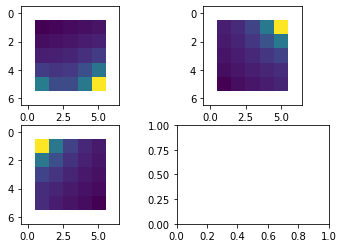

In [ ]:
start = s2f(10)
stop  = s2f(20)

stop = 1000
start = 0
A,W = do_ICA(X,3)

S = W @ X
start = s2f(20)
stop  = s2f(40)
for i in range(S.shape[0]):
  display(Audio(S[i,start:stop],rate=samplerate))
plot_topos(A,sensor_locs,num_cols+1,num_rows+1)


- Una de las fuentes queda unida a otra.
- El orden de descomposición es un parámetro importante a tener en cuenta al usar el algoritmo.

#### 4.7 Afecte 5 sensores mediante ruido uniforme e ingrese esos datos al ICA. ¿Que orden de descomposición debería usar? ¿Es posible aún separar la señal?

Grafique y escuche los resultados. BAJE EL VOLUMEN porque las fuentes resultantes pueden ser ruidos completamente.

In [ ]:
sensors_idx = [1,3,7,5,9]
X2 = X.copy()

X2[sensors_idx,:] = X[sensors_idx,:]+np.random.uniform(low=0.0, high=1.0, size=X[sensors_idx,:].shape)

del X # para ahorrar RAM

A,W = do_ICA(X2,9)

S = W @ X2
start = s2f(20)
stop  = s2f(40)
for i in range(S.shape[0]):
  display(Audio(S[i,start:stop],rate=samplerate))
plot_topos(A,sensor_locs,num_cols+1,num_rows+1)


- Si se usa como orden de descomposición = 9 = 4 Instrumentos + 5 sensores ruidosos, es posible seguir separando la señal.
- Esto es posible ya que la cantidad de sensores buenos sigue superando en buen número a la cantidad de fuentes.

### 5. Conclusiones
- El algoritmo ICA es capaz de separar señales incluso cuando su contenido frecuencial es solapado
- Sin embargo para poder separar el algoritmo necesita diferentes sensores que hayan capturada diferentes formas de mezcla de las señales que se desean separar
- Las matrices de Mezcla ($A$) y Desmezcla ($W$) capturan información acerca de la topografía de mezcla a pesar de que en el modelo del ICA no haya un factor propiamente geométrico.
- Mientras se tengan suficientes sensores buenos es posible seguir separando las señales a pesar de que hayan sensores ruidosos.
- El ICA no recupera el orden original de las señales.
- El ICA no recuperar la fase de la señales.
- El orden de descomposición es un parámetro fundamental a escoger para el algoritmo.
- Mientras más datos tenga el ICA, mejor será la descomposición.